In [2]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import json



In [58]:
# Define the URL for the SEC EDGAR search page
url = "https://www.sec.gov/files/company_tickers_exchange.json"

headers = {
   "User-Agent": "your.email@email.com"
}
# Fetch the HTML content of the search page
response = requests.get(url,headers=headers)
html_content = response.content

# Parse the HTML content using BeautifulSoup
soup = BeautifulSoup(html_content, 'html.parser')

In [59]:
# Parse the JSON content from the BeautifulSoup object
json_data = json.loads(soup.text)

# Convert the JSON data into a pandas DataFrame
df_cik_lookup = pd.DataFrame(json_data['data'], columns=json_data['fields'])


# df_cik_lookup['cik']=df_cik_lookup['cik'].astype(str).zfill(10)
df_cik_lookup

,cik,name,ticker,exchange
0,320193,Apple Inc.,AAPL,Nasdaq
1,1045810,NVIDIA CORP,NVDA,Nasdaq
2,789019,MICROSOFT CORP,MSFT,Nasdaq
3,1652044,Alphabet Inc.,GOOGL,Nasdaq
4,1018724,AMAZON COM INC,AMZN,Nasdaq
...,...,...,...,...
10190,2024203,Cayson Acquisition Corp,CAPNU,Nasdaq
10191,2025065,Black Spade Acquisition II Co,BSIIU,Nasdaq
10192,2025065,Black Spade Acquisition II Co,BSIIW,Nasdaq
10193,2025341,Andretti Acquisition Corp. II,POLEU,Nasdaq


In [3]:
cik_list = [
    '0000320193',
    '0001045810',
    '0000789019',
    '0001652044',
    '0001018724',
    '0001326801'
]

In [4]:
def make_edgar_request(url):
    """
    Make a request to EDGAR (Electronic Data Gathering, Analysis and Retrieval)
    :param url: request URL
    :return: response
    """
    headers = {
        "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/113.0.0.0 Safari/537.36",
        "Accept-Encoding": "gzip, deflate, br",
    }
    return requests.get(url, headers=headers)

In [5]:
def download_financial_data(cik):
    """
    Download financial data for a company.
    Upsert document on mongodb (each requests returns the entire history)
    :param cik: company cik
    :return:
    """
    url = f"https://data.sec.gov/api/xbrl/companyfacts/CIK{cik}.json"
    response = make_edgar_request(url)
    
    try:
        r = response.json()
        r["_id"] = cik
        r["url"] = url
        data=r
        
    # ETFs, funds, trusts do not have financial information
    except:
        print(f"ERROR {cik} - {response} - {url}")
        print(company_from_cik(cik))
    return data

In [6]:
data = [download_financial_data(cik) for cik in cik_list]

In [7]:
data

[{'cik': 320193,
  'entityName': 'Apple Inc.',
  'facts': {'dei': {'EntityCommonStockSharesOutstanding': {'label': 'Entity Common Stock, Shares Outstanding',
     'description': "Indicate number of shares or other units outstanding of each of registrant's classes of capital or common stock or other ownership interests, if and as stated on cover of related periodic report. Where multiple classes or units exist define each class/interest by adding class of stock items such as Common Class A [Member], Common Class B [Member] or Partnership Interest [Member] onto the Instrument [Domain] of the Entity Listings, Instrument.",
     'units': {'shares': [{'end': '2009-06-27',
        'val': 895816758,
        'accn': '0001193125-09-153165',
        'fy': 2009,
        'fp': 'Q3',
        'form': '10-Q',
        'filed': '2009-07-22',
        'frame': 'CY2009Q2I'},
       {'end': '2009-10-16',
        'val': 900678473,
        'accn': '0001193125-09-214859',
        'fy': 2009,
        'fp': 'FY

In [11]:
# Initialize an empty list to store the DataFrames
df_list = []

# Iterate through the data list
for item in data:
    # Normalize the 'facts' field in the data dictionary
    df_facts = pd.json_normalize(item['facts'], sep='_')
    
    # Add a column with the cik
    df_facts['cik'] = item['_id']
    
    # Append the DataFrame to the list
    df_list.append(df_facts)

# Concatenate all DataFrames in the list into a single DataFrame
df_combined = pd.concat(df_list, ignore_index=True)

# Display the combined DataFrame
df_combined

,dei_EntityCommonStockSharesOutstanding_label,dei_EntityCommonStockSharesOutstanding_description,dei_EntityCommonStockSharesOutstanding_units_shares,dei_EntityPublicFloat_label,dei_EntityPublicFloat_description,dei_EntityPublicFloat_units_USD,us-gaap_AccountsPayable_label,us-gaap_AccountsPayable_description,us-gaap_AccountsPayable_units_USD,us-gaap_AccountsPayableCurrent_label,...,us-gaap_ShareBasedCompensationArrangementByShareBasedPaymentAwardNumberOfAdditionalSharesAuthorized_units_shares,us-gaap_DividendsCommonStock_label,us-gaap_DividendsCommonStock_description,us-gaap_DividendsCommonStock_units_USD,us-gaap_NetIncomeLossAttributableToParentDiluted_label,us-gaap_NetIncomeLossAttributableToParentDiluted_description,us-gaap_NetIncomeLossAttributableToParentDiluted_units_USD,us-gaap_UndistributedEarnings_label,us-gaap_UndistributedEarnings_description,us-gaap_UndistributedEarnings_units_USD
0,"Entity Common Stock, Shares Outstanding",Indicate number of shares or other units outst...,"[{'end': '2009-06-27', 'val': 895816758, 'accn...",Entity Public Float,The aggregate market value of the voting and n...,"[{'end': '2009-03-28', 'val': 94593000000, 'ac...",Accounts Payable (Deprecated 2009-01-31),Carrying value as of the balance sheet date of...,"[{'end': '2008-09-27', 'val': 5520000000, 'acc...","Accounts Payable, Current",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"Entity Common Stock, Shares Outstanding",Indicate number of shares or other units outst...,"[{'end': '2009-08-17', 'val': 547800000, 'accn...",Entity Public Float,The aggregate market value of the voting and n...,"[{'end': '2008-07-27', 'val': 6100000000, 'acc...",NaN,NaN,NaN,"Accounts Payable, Current",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"Entity Common Stock, Shares Outstanding",Indicate number of shares or other units outst...,"[{'end': '2009-10-19', 'val': 8879121378, 'acc...",Entity Public Float,The aggregate market value of the voting and n...,"[{'end': '2009-12-31', 'val': 235244858633, 'a...",NaN,NaN,NaN,"Accounts Payable, Current",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,Entity Public Float,The aggregate market value of the voting and n...,"[{'end': '2015-06-30', 'val': 0, 'accn': '0001...",NaN,NaN,NaN,"Accounts Payable, Current",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,"Entity Common Stock, Shares Outstanding",Indicate number of shares or other units outst...,"[{'end': '2009-07-17', 'val': 431807370, 'accn...",Entity Public Float,The aggregate market value of the voting and n...,"[{'end': '2008-06-30', 'val': 23846135567, 'ac...",Accounts Payable (Deprecated 2009-01-31),Carrying value as of the balance sheet date of...,"[{'end': '2008-12-31', 'val': 3594000000, 'acc...","Accounts Payable, Current",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,Entity Public Float,The aggregate market value of the voting and n...,"[{'end': '2012-06-29', 'val': 47206114899, 'ac...",NaN,NaN,NaN,"Accounts Payable, Current",...,"[{'end': '2023-01-01', 'val': 56000000, 'accn'...","Dividends, Common Stock",Amount of paid and unpaid common stock dividen...,"[{'start': '2024-01-01', 'end': '2024-03-31', ...","Net Income (Loss) Attributable to Parent, Diluted","The portion of profit or loss for the period, ...","[{'start': '2023-01-01', 'end': '2023-03-31', ...","Undistributed Earnings, Basic",The earnings that is allocated to common stock...,"[{'start': '2023-01-01', 'end': '2023-03-31', ..."


In [21]:
# Function to extract year-wise data
def extract_yearly_data(df,column_prefix, cik):
    yearly_data = []
    for index, row in df.iterrows():
        for col in df.columns:
            if col.startswith(column_prefix) and isinstance(row[col], list):
                for entry in row[col]:
                    entry_data = entry.copy()
                    entry_data['year'] = entry_data['fy']
                    entry_data['label'] = col
                    yearly_data.append(entry_data)
                    entry_data['cik'] = cik 
    return pd.DataFrame(yearly_data)


In [27]:

df_yearly_list = []
# Extract year-wise data for 'us-gaap' columns
for i in range(len(df_list)):
    df_yearly_us_gaap = extract_yearly_data(df_list[i],'us-gaap', cik_list[i])
    # Display the new DataFrame
    df_yearly_list.append(df_yearly_us_gaap)

# Display the new DataFrame
df_yearly_combined = pd.concat(df_yearly_list, ignore_index=True)
df_yearly_combined

,end,val,accn,fy,fp,form,filed,frame,year,label,cik,start
0,2008-09-27,5.520000e+09,0001193125-09-153165,2009,Q3,10-Q,2009-07-22,CY2008Q3I,2009,us-gaap_AccountsPayable_units_USD,0000320193,NaN
1,2009-06-27,4.854000e+09,0001193125-09-153165,2009,Q3,10-Q,2009-07-22,CY2009Q2I,2009,us-gaap_AccountsPayable_units_USD,0000320193,NaN
2,2008-09-27,5.520000e+09,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
3,2008-09-27,5.520000e+09,0001193125-10-012091,2009,FY,10-K/A,2010-01-25,CY2008Q3I,2009,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
4,2009-09-26,5.601000e+09,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
132156,2024-03-31,1.109600e+10,0001326801-24-000049,2024,Q1,10-Q,2024-04-25,CY2024Q1,2024,us-gaap_UndistributedEarnings_units_USD,0001326801,2024-01-01
132157,2024-06-30,2.329500e+10,0001326801-24-000069,2024,Q2,10-Q,2024-08-01,NaN,2024,us-gaap_UndistributedEarnings_units_USD,0001326801,2024-01-01
132158,2024-06-30,1.219900e+10,0001326801-24-000069,2024,Q2,10-Q,2024-08-01,CY2024Q2,2024,us-gaap_UndistributedEarnings_units_USD,0001326801,2024-04-01
132159,2024-06-30,1.000000e+00,0001326801-24-000069,2024,Q2,10-Q,2024-08-01,NaN,2024,us-gaap_CommonStockDividendsPerShareDeclared_u...,0001326801,2024-01-01


In [29]:
df_10k = df_yearly_combined[df_yearly_combined['form'] == '10-K']
df_10k

,end,val,accn,fy,fp,form,filed,frame,year,label,cik,start
2,2008-09-27,5.520000e+09,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
4,2009-09-26,5.601000e+09,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
9,2009-09-26,5.601000e+09,0001193125-10-238044,2010,FY,10-K,2010-10-27,CY2009Q3I,2010,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
13,2010-09-25,1.201500e+10,0001193125-10-238044,2010,FY,10-K,2010-10-27,NaN,2010,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
17,2010-09-25,1.201500e+10,0001193125-11-282113,2011,FY,10-K,2011-10-26,CY2010Q3I,2011,us-gaap_AccountsPayableCurrent_units_USD,0000320193,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
132121,2022-12-31,4.890000e+08,0001326801-24-000012,2023,FY,10-K,2024-02-02,CY2022Q4I,2023,us-gaap_DeferredTaxAssetsUnrealizedLossesOnAva...,0001326801,NaN
132122,2023-12-31,2.320000e+08,0001326801-24-000012,2023,FY,10-K,2024-02-02,CY2023Q4I,2023,us-gaap_DeferredTaxAssetsUnrealizedLossesOnAva...,0001326801,NaN
132123,2021-12-31,-5.040000e+08,0001326801-24-000012,2023,FY,10-K,2024-02-02,CY2021,2023,us-gaap_OtherComprehensiveIncomeUnrealizedHold...,0001326801,2021-01-01
132124,2022-12-31,-1.653000e+09,0001326801-24-000012,2023,FY,10-K,2024-02-02,CY2022,2023,us-gaap_OtherComprehensiveIncomeUnrealizedHold...,0001326801,2022-01-01


In [46]:
# Convert 'end' column to datetime
df_10k['end'] = pd.to_datetime(df_10k['end'])

# Group by 'year', 'cik', and 'label', and get the index of the maximum 'end' date
idx = df_10k.groupby(['year', 'cik', 'label'])['end'].idxmax()

# Use the indices to get the most recent entries
df_10k_most_recent = df_10k.loc[idx].reset_index(drop=True)

df_10k_most_recent
df_10k=df_10k_most_recent

C:\Users\madhu\AppData\Local\Temp\ipykernel_158064\1304730199.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_10k['end'] = pd.to_datetime(df_10k['end'])


In [47]:
# Extract unique labels from df_10k and remove 'us-gaap_' and '_units_USD'
df_10k['label'] = df_10k['label'].str.replace('us-gaap_', '').str.replace('_units_USD', '')


In [48]:
# Group the 10-K filings by cik and label
df_10k_grouped_by_cik_label = df_10k.groupby(['cik', 'label'])

# Iterate through each group and list the CIKs and labels
for (cik, label), group in df_10k_grouped_by_cik_label:
    print(f"CIK: {cik}, Label: {label}")
    print(group)
    print("\n")


CIK: 0000320193, Label: AccountsPayableCurrent
             end           val                  accn    fy  fp  form  \
0     2009-09-26  5.601000e+09  0001193125-09-214859  2009  FY  10-K   
166   2010-09-25  1.201500e+10  0001193125-10-238044  2010  FY  10-K   
1058  2011-09-24  1.463200e+10  0001193125-11-282113  2011  FY  10-K   
1983  2012-09-29  2.117500e+10  0001193125-12-444068  2012  FY  10-K   
3108  2013-09-28  2.236700e+10  0001193125-13-416534  2013  FY  10-K   
4230  2014-09-27  3.019600e+10  0001193125-14-383437  2014  FY  10-K   
5382  2015-09-26  3.549000e+10  0001193125-15-356351  2015  FY  10-K   
6814  2016-09-24  3.729400e+10  0001628280-16-020309  2016  FY  10-K   
8196  2017-09-30  4.904900e+10  0000320193-17-000070  2017  FY  10-K   
9537  2018-09-29  5.588800e+10  0000320193-18-000145  2018  FY  10-K   
10873 2019-09-28  4.623600e+10  0000320193-19-000119  2019  FY  10-K   
12260 2020-09-26  4.229600e+10  0000320193-20-000096  2020  FY  10-K   
13634 2021-09-25 

In [49]:
df_10k_grouped_by_cik_label.groups

{('0000320193', 'AccountsPayableCurrent'): [0, 166, 1058, 1983, 3108, 4230, 5382, 6814, 8196, 9537, 10873, 12260, 13634, 14770, 16153], ('0000320193', 'AccountsReceivableNetCurrent'): [1, 167, 1059, 1984, 3109, 4231, 5383, 6815, 8197, 9538, 10874, 12261, 13635, 14771, 16154], ('0000320193', 'AccruedIncomeTaxesCurrent'): [168, 16155], ('0000320193', 'AccruedIncomeTaxesNoncurrent'): [9539, 10875, 12262, 13636, 14772, 16156], ('0000320193', 'AccruedLiabilitiesCurrent'): [2, 169, 1060, 1985, 3110, 4232, 5384, 6816, 8198], ('0000320193', 'AccruedMarketingCostsCurrent'): [1986, 3111, 4233], ('0000320193', 'AccumulatedDepreciationDepletionAndAmortizationPropertyPlantAndEquipment'): [1987, 3112, 4234, 5385, 6817, 8199, 9540, 10876, 12263, 13637, 14773, 16157], ('0000320193', 'AccumulatedOtherComprehensiveIncomeLossAvailableForSaleSecuritiesAdjustmentNetOfTax'): [170, 1061, 1988, 3113], ('0000320193', 'AccumulatedOtherComprehensiveIncomeLossCumulativeChangesInNetGainLossFromCashFlowHedgesEffect

In [ ]:
import matplotlib.pyplot as plt

data_list = [
    "AccountsPayableCurrent",
    "AllocatedShareBasedCompensationExpense",
    "Assets",
    "AssetsCurrent",
    "CashAndCashEquivalentsAtCarryingValue",
    "ComprehensiveIncomeNetOfTax",
    "CurrentFederalTaxExpenseBenefit",
    "CurrentStateAndLocalTaxExpenseBenefit",
    "DeferredFederalIncomeTaxExpenseBenefit",
    "IncomeTaxExpenseBenefit",
    "LesseeOperatingLeaseLiabilityPaymentsDueNextTwelveMonths",
    "LiabilitiesAndStockholdersEquity",
    "LiabilitiesCurrent",
    "NetIncomeLoss",
    "OperatingIncomeLoss",
    "OperatingLeasePayments",
    "PropertyPlantAndEquipmentGross",
    "PropertyPlantAndEquipmentNet",
    "ShareBasedCompensation",
    "StockholdersEquity",
    "UnrecognizedTaxBenefits"
]

for label in data_list:
    if any(label in l for _, l in df_10k_grouped_by_cik_label.groups.keys()):
        plt.figure(figsize=(10, 5))
        for cik in cik_list:
            group = df_10k_grouped_by_cik_label.get_group((cik, label)).sort_values(by='year')
            plt.plot(group['year'], group['val'], marker='o', label=f'{label} - {cik}')
        plt.title(f'Value Over Time for {label}')
        plt.xlabel('Year')
        plt.ylabel('Value')
        plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
        plt.grid(True)
        plt.legend()
        plt.show()
    else:
        print(f"Label '{label}' not found in df_10k_grouped_by_cik_label")


In [52]:
# Save the DataFrame to a CSV file
df_10k.to_csv('financial_data.csv', index=False)

In [53]:
filtered_df_10k = df_10k[df_10k['label'].isin(data_list)]
filtered_df_10k

,end,val,accn,fy,fp,form,filed,frame,year,label,cik,start
0,2009-09-26,5.601000e+09,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,AccountsPayableCurrent,0000320193,NaN
7,2009-09-26,5.385100e+10,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,Assets,0000320193,NaN
8,2009-09-26,3.626500e+10,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,AssetsCurrent,0000320193,NaN
11,2009-09-26,5.263000e+09,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,CashAndCashEquivalentsAtCarryingValue,0000320193,NaN
18,2009-09-26,5.780000e+09,0001193125-09-214859,2009,FY,10-K,2009-10-27,NaN,2009,ComprehensiveIncomeNetOfTax,0000320193,2008-09-28
...,...,...,...,...,...,...,...,...,...,...,...,...
17995,2024-01-28,7.423000e+09,0001045810-24-000029,2024,FY,10-K,2024-02-21,CY2023Q4I,2024,PropertyPlantAndEquipmentGross,0001045810,NaN
17996,2024-01-28,3.914000e+09,0001045810-24-000029,2024,FY,10-K,2024-02-21,NaN,2024,PropertyPlantAndEquipmentNet,0001045810,NaN
18010,2024-01-28,3.549000e+09,0001045810-24-000029,2024,FY,10-K,2024-02-21,CY2023,2024,ShareBasedCompensation,0001045810,2023-01-30
18024,2024-01-28,4.297800e+10,0001045810-24-000029,2024,FY,10-K,2024-02-21,NaN,2024,StockholdersEquity,0001045810,NaN


In [54]:
filtered_df_10k.to_csv('filtered_financial_data.csv', index=False)

In [61]:
# Assuming we have a DataFrame `market_cap_df` with columns 'cik' and 'market_cap'
# Example:
# market_cap_df = pd.DataFrame({
#     'cik': ['0000320193', '0001045810', '0000789019', '0001652044', '0001018724', '0001326801'],
#     'market_cap': [2500000000000, 500000000000, 2000000000000, 1500000000000, 1600000000000, 900000000000]
# })

# Filter the NetIncomeLoss data
net_income_df = df_10k[df_10k['label'] == 'NetIncomeLoss']

# Merge with market capitalization data
pe_ratio_df = net_income_df.merge(market_cap_df, on='cik')

# Calculate P/E ratio
pe_ratio_df['pe_ratio'] = pe_ratio_df['market_cap'] / pe_ratio_df['val']

# Display the P/E ratio DataFrame
pe_ratio_df[['cik', 'year', 'market_cap', 'val', 'pe_ratio']]

,cik,year,market_cap,val,pe_ratio
0,0000320193,2009,3555478994944,5.704000e+09,623.330820
1,0001018724,2009,1969919098880,9.020000e+08,2183.945786
2,0000320193,2010,3555478994944,1.401300e+10,253.727182
3,0000789019,2010,3112510947328,1.876000e+10,165.912097
4,0001018724,2010,1969919098880,1.152000e+09,1709.999218
...,...,...,...,...,...
75,0001045810,2023,3228148170752,4.368000e+09,739.044911
76,0001326801,2023,1483157536768,3.909800e+10,37.934358
77,0001652044,2023,2045092429824,7.379500e+10,27.713157
78,0000789019,2024,3112510947328,8.813600e+10,35.314865


In [ ]:
import yfinance as yf

# Initialize an empty list to store the market cap data
market_cap_data = []

# Iterate through the df_cik_lookup dataframe
for index, row in df_cik_lookup.iterrows():
    cik = str(row['cik']).zfill(10)
    ticker = row['ticker']
    
    # Fetch the market cap using Yahoo Finance API
    stock = yf.Ticker(ticker)
    market_cap = stock.info.get('marketCap', None)
    
    # Append the data to the list if market cap is available
    if market_cap is not None:
        market_cap_data.append({'cik': cik, 'market_cap': market_cap})

# Create a DataFrame from the market cap data
market_cap_df = pd.DataFrame(market_cap_data)

# Display the DataFrame
market_cap_df


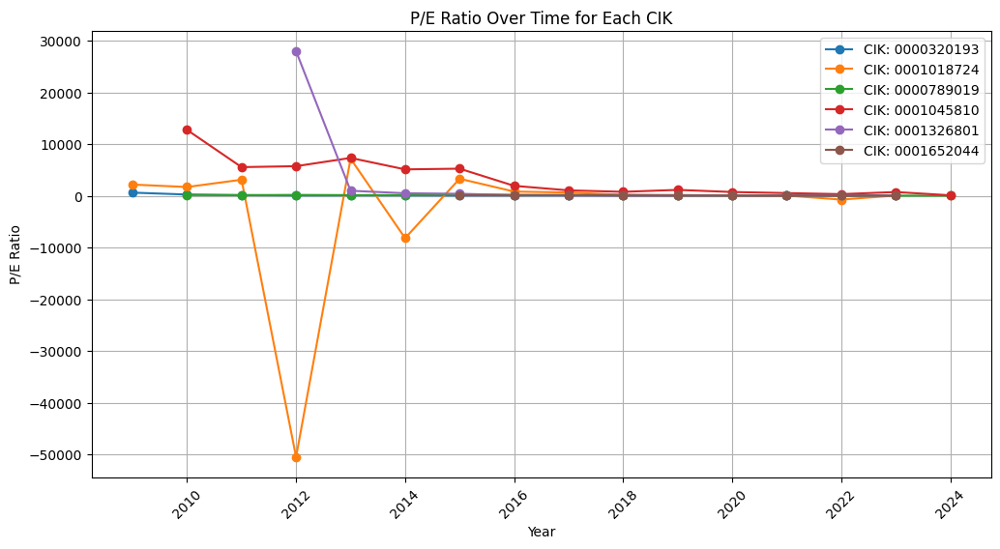

In [62]:
import matplotlib.pyplot as plt

# Plot the P/E ratio for each CIK
plt.figure(figsize=(12, 6))
for cik in pe_ratio_df['cik'].unique():
    cik_data = pe_ratio_df[pe_ratio_df['cik'] == cik]
    plt.plot(cik_data['year'], cik_data['pe_ratio'], marker='o', label=f'CIK: {cik}')

plt.title('P/E Ratio Over Time for Each CIK')
plt.xlabel('Year')
plt.ylabel('P/E Ratio')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.legend()
plt.show()